## Load required packages and data

In [1]:
import os
import pandas as pd
import numpy as np
import folium
import geojson
import glob #library that puts all the csv/excel  files together


import plotly.express as px


#matplotlib
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt


In [2]:
# # these packages are needed to export plotly images
# !pip install -U kaleido
# !conda install -c conda-forge python-kaleido

## Functions to automatically draw heatmaps from geographical data

In [3]:
# coord range for data:
def get_range(data):
    xy_range = [[data['Latitude'].min(),data['Latitude'].max()],
              [data['Longitude'].min(),data['Longitude'].max()]]
    return xy_range


# create function to convert any latitude to a unit between 0 and n-1

# calculate increment sizes based on desired grid number m:

def d_loc(m, xy_range):
    d_lat = (xy_range[0][1]-xy_range[0][0])/m
    d_lon = (xy_range[1][1]-xy_range[1][0])/m
    return (d_lat, d_lon)

# convert any given latitude INSIDE range 
def lat_u(lat, m, xy_range):
    # determin min and max lat
    lat_min = xy_range[0][0]
    lat_max = xy_range[0][1]
    # calculate increment
    d_lat = (lat_max-lat_min)/m
    
    if lat_min <= lat <= lat_max:
        return int((lat-lat_min)//d_lat)
    else:
        return np.nan

def lon_u(lon, m, xy_range):
    # determine min and max lon
    lon_min = xy_range[1][0]
    lon_max = xy_range[1][1]
    d_lon = (lon_max-lon_min)/m
    
    if lon_min <= lon <= lon_max:
        return int((lon-lon_min)//d_lon)
    else:
        return np.nan
    
  
    

# write a function to convert property value in to a long-form data for grid
# take m to be the number of increments in grid
# will work with {'FULLVAL', 'Latitude','Longitude','POSTCODE'}
# depend on xy_range

def gridify(m, data, xy_range):
    # convert lat and lon to incremental units
    data['lat_u'] = data['Latitude'].apply(lambda x: lat_u(x, m , xy_range = xy_range))
    data['lon_u'] = data['Longitude'].apply(lambda x: lon_u(x, m , xy_range = xy_range))

    # total value per grid unit
    val_grid = data.groupby(['lat_u', 'lon_u', 'YEAR']).agg({'FULLVAL':'sum', 
                                                                 'Latitude': 'median',
                                                                 'Longitude':'median',
                                                                 'POSTCODE': 'median'
                                                                     })

    # calculate percentage change in prop values
    val_grid=val_grid.assign(val_pct=val_grid.groupby(['lat_u', 'lon_u'])['FULLVAL'].pct_change()*100)
#     prop_val_grid=prop_val_grid.assign(tot_pct=prop_val_grid.groupby(['lat_u', 'lon_u'])['AVTOT'].pct_change())

    val_grid=val_grid.reset_index()
    return val_grid



# function to create plot based on grid data
# val_grid must have lat_u, lon_u, and val_pct

def plot_grid(val_grid, m, xy_range, d_lat , d_lon, top_quant = 0.99, val = "Property Value", yr=2019):
    xy_range=xy_range
    d_lat=d_lat
    d_lon=d_lon
    x_min = xy_range[0][0]
    y_min = xy_range[1][0]
    upper_lim = val_grid['val_pct'].quantile(top_quant)
    lower_lim = val_grid['val_pct'].quantile(1-top_quant)

    map_title= val+" in "+str(yr)

    prop_pct19 = val_grid[val_grid['YEAR']==yr]


    prop_pct19 = prop_pct19.pivot(index='lat_u',columns='lon_u',values='val_pct')
    prop_pct19 = prop_pct19.iloc[::-1]
    x_axis_values = np.linspace(0,prop_pct19.shape[1]-1, prop_pct19.shape[1])*d_lat+x_min
    y_axis_values = np.linspace(0,prop_pct19.shape[0]-1, prop_pct19.shape[0])*d_lon+y_min
    fig = px.imshow(prop_pct19,
                    labels=dict(x="Longitude", 
                                y="Latitude",
                                color="Pct Change"),
                    x=x_axis_values,
                    y=y_axis_values,
                    color_continuous_scale=px.colors.diverging.PiYG,
                    zmax = upper_lim,
                    zmin = -upper_lim
                   )
    fig.update_layout(
        autosize=False,
        width=600,
        height=600,
        title=map_title
    )
    fig.show()
    


# required columns: ['FULLVAL', 'YEAR', 'Latitude','Longitude','POSTCODE']

def plot_val_grid(data_name,val_name="Property Value", grid_size=200, top_qtl=.99):
# coord range for data:
    xy_range = get_range(data=data_name)
    val_grid= gridify(m=grid_size, data=data_name, xy_range=xy_range)
    d_lat, d_lon = d_loc(m=grid_size, xy_range=xy_range)    
    for year in np.sort(data_name['YEAR'].unique())[1:]:
        plot_grid(val_grid=val_grid,
                  m=grid_size, 
                  xy_range=xy_range,d_lat=d_lat,d_lon=d_lon, 
                  top_quant = top_qtl, 
                  val=val_name, 
                  yr=year)
 

## Exploring property value data

In [4]:
# housing data a bit more complicate:
# create grid
# total value increase for each grid
prop_val = pd.read_csv('data/Property_Valuation_and_Assessment_Data.csv')

In [5]:
prop_val.columns

Index(['BBLE', 'BORO', 'BLOCK', 'LOT', 'EASEMENT', 'OWNER', 'BLDGCL',
       'TAXCLASS', 'LTFRONT', 'LTDEPTH', 'EXT', 'STORIES', 'FULLVAL', 'AVLAND',
       'AVTOT', 'EXLAND', 'EXTOT', 'EXCD1', 'STADDR', 'POSTCODE', 'EXMPTCL',
       'BLDFRONT', 'BLDDEPTH', 'AVLAND2', 'AVTOT2', 'EXLAND2', 'EXTOT2',
       'EXCD2', 'PERIOD', 'YEAR', 'VALTYPE', 'Borough', 'Latitude',
       'Longitude', 'Community Board', 'Council District', 'Census Tract',
       'BIN', 'NTA', 'New Georeferenced Column'],
      dtype='object')

In [6]:
len(prop_val.BORO)

9845857

In [7]:
len(prop_val.FULLVAL)

9845857

In [8]:
len(prop_val.Latitude)

9845857

In [9]:
prop_val.groupby('YEAR')['FULLVAL'].count()

YEAR
2010/11    1070995
2011/12    1080569
2012/13    1086396
2013/14    1088350
2014/15    1093327
2015/16    1096247
2016/17    1103323
2017/18    1110058
2018/19    1116592
Name: FULLVAL, dtype: int64

In [10]:
# pandas can't provide details beyond a certain point: prop_val.info()

In [11]:
# note that tax year span from one cal year to another
print(prop_val['YEAR'].unique())


prop_val['YEAR'] = prop_val['YEAR'].apply(lambda yr: yr[:2]+yr[-2:]).astype(int)
prop_val['YEAR'].describe()

['2018/19' '2017/18' '2016/17' '2015/16' '2014/15' '2013/14' '2012/13'
 '2010/11' '2011/12']


count    9.845857e+06
mean     2.015032e+03
std      2.582216e+00
min      2.011000e+03
25%      2.013000e+03
50%      2.015000e+03
75%      2.017000e+03
max      2.019000e+03
Name: YEAR, dtype: float64

In [12]:
# IMPORTANT: include only residential
prop_val = prop_val[~prop_val['TAXCLASS'].isin(['3','4'])]

In [13]:
   
plot_val_grid(data_name=prop_val,val_name="Property Value", grid_size=200, top_qtl=.99)

In [14]:
# percentage change from 2011 to 2019
prop_val_1119 = prop_val[prop_val['YEAR'].isin([2011,2019])]

plot_val_grid(data_name=prop_val_1119,val_name="Property Value relative to 2011", grid_size=300, top_qtl=.99)

<ipython-input-3-d1506aec637c>:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-3-d1506aec637c>:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Exploring Eviction Data

In [15]:
# eviction data
evictions_df=pd.read_csv('https://data.cityofnewyork.us/api/views/6z8x-wfk4/rows.csv?accessType=DOWNLOAD')
nta_evictions_df=evictions_df.groupby(['NTA'])['Eviction Address'].count().reset_index()

In [16]:
evictions_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66405 entries, 0 to 66404
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Court Index Number         66405 non-null  object 
 1   Docket Number              66405 non-null  int64  
 2   Eviction Address           66405 non-null  object 
 3   Eviction Apartment Number  55422 non-null  object 
 4   Executed Date              66405 non-null  object 
 5   Marshal First Name         66405 non-null  object 
 6   Marshal Last Name          66405 non-null  object 
 7   Residential/Commercial     66405 non-null  object 
 8   BOROUGH                    66405 non-null  object 
 9   Eviction Postcode          66405 non-null  int64  
 10  Ejectment                  66405 non-null  object 
 11  Eviction/Legal Possession  66405 non-null  object 
 12  Latitude                   60091 non-null  float64
 13  Longitude                  60091 non-null  flo

In [17]:
# get the year
evictions_df['Date']=pd.to_datetime(evictions_df['Executed Date'])
evictions_df['Year']=pd.DatetimeIndex(evictions_df['Date']).year
evictions_df['Year']=evictions_df['Year'].replace(2070, 2017)

In [18]:
evictions_df['Year'].describe()

count    66405.000000
mean      2018.043973
std          0.907501
min       2017.000000
25%       2017.000000
50%       2018.000000
75%       2019.000000
max       2021.000000
Name: Year, dtype: float64

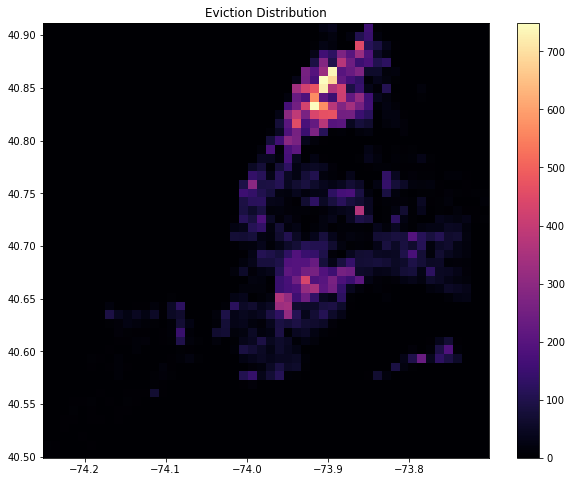

In [19]:
# create 2d histogram based on lat and long:
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt

eviction_20 = evictions_df[evictions_df['Year']>2015][['Longitude', 'Latitude']].dropna()
x = eviction_20.iloc[:,0]
y = eviction_20.iloc[:,1]

eviction_range = [[x.min(),x.max()], [y.min(), y.max()]]

# set colormap
plt.subplots(figsize=(10, 8))
plt.rcParams["image.cmap"] = "magma"

plt.hist2d(x,y, 
           bins=50,
           range = eviction_range
#            norm=LogNorm()
          )
plt.colorbar()

plt.title('Eviction Distribution')

plt.show()



In [20]:
# eviction data
evictions_df=pd.read_csv('https://data.cityofnewyork.us/api/views/6z8x-wfk4/rows.csv?accessType=DOWNLOAD')


# need some preprocessing
evictions_df = evictions_df[['Executed Date', 'Eviction Postcode', 'Latitude', 'Longitude']]
evictions_df.columns = ['Executed Date', 'POSTCODE', 'Latitude', 'Longitude']
evictions_df['FULLVAL'] = 1
evictions_df['Date']=pd.to_datetime(evictions_df['Executed Date'])
evictions_df['YEAR']=pd.DatetimeIndex(evictions_df['Date']).year
evictions_df['YEAR']=evictions_df['YEAR'].replace(2070, 2017)

evictions_df.columns

Index(['Executed Date', 'POSTCODE', 'Latitude', 'Longitude', 'FULLVAL', 'Date',
       'YEAR'],
      dtype='object')

In [21]:
plot_val_grid(data_name=evictions_df,val_name="Eviction Count", grid_size=100, top_qtl=.99)

## Exploring Police Encounter Data (Same code as in EDA for Zip Code)

The file 'data/frisk_df.csv' is too large to commit to github. User need to download it before use.

In [22]:
# #get all csv file names
# filepath='data/sqf'
# all_excel_files = glob.glob(filepath + "/*.xlsx")
# all_csv_files = glob.glob(filepath + "/*.csv")

# #put all csv file names into a list
# li = []

# for filename in all_csv_files:
#     df = pd.read_csv(filename)
#     li.append(df)
    
# for filename in all_excel_files:
#     df = pd.read_excel(filename)
#     li.append(df)

# #concatenate all excel files into a dataframe
# df = pd.concat(li, axis=0)

# #merge the x and y coordinates in datasets with different column names 
# df['x']=df['STOP_LOCATION_X'].fillna(df['xcoord'])
# df['y']=df['STOP_LOCATION_Y'].fillna(df['ycoord'])

# #drop null/empty x and y
# df=df[df['x']!=' ']
# df=df[~df['x'].isnull()]
# df=df[df['y']!=' ']
# df=df[~df['y'].isnull()]

# #convert x and y to integers
# df['x']=df['x'].astype(int)
# df['y']=df['y'].astype(int)

# df

In [23]:
# #read csv file for xy to zip code mapping
# df_zipcode=pd.read_csv('xy_zipcode_2013to2019.csv')

# #merge xy with zip codes
# frisk_df=df.merge(df_zipcode, left_on=['x','y'], right_on=['x','y'], how='outer')

# #drop rows with null zip codes
# frisk_df = frisk_df[~frisk_df['zipcode'].isnull()]

# #merge the two column names with year data and convert to int
# frisk_df['year']= (frisk_df['year'].fillna(frisk_df['YEAR2']))
# frisk_df=frisk_df[frisk_df['year']!=' ']
# frisk_df['year']=frisk_df['year'].astype(int)

# frisk_df['race']=frisk_df['race'].fillna(frisk_df['SUSPECT_RACE_DESCRIPTION'])

# frisk_df_suspect=frisk_df[(frisk_df['race']!='W') &  (frisk_df['race']!='WHITE')]

# frisk_df_suspect

In [24]:
# # generate frisk_df.csv
# frisk_df_suspect.to_csv('data/frisk_df.csv')

In [25]:
frisk_df = pd.read_csv('data/frisk_df.csv')

/Users/jasontan/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning:

Columns (6,7,8,10,11,12,13,14,15,16,17,18,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,76,77,78,79,80,81,83,84,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,105,106,107,110,125,176,179,180,189,196) have mixed types.Specify dtype option on import or set low_memory=False.



In [26]:
#merge the two column names with year data and convert to int
frisk_df['year']= (frisk_df['year'].fillna(frisk_df['YEAR2']))
frisk_df=frisk_df[frisk_df['year']!=' ']
frisk_df['year']=frisk_df['year'].astype(int)

frisk_df['race']=frisk_df['race'].fillna(frisk_df['SUSPECT_RACE_DESCRIPTION'])


In [27]:
# # uncomment this to create csv that maps xy to zip code
# import warnings
# import pycrs
# import pyproj
# from functools import lru_cache

# # supress warnings
# warnings.filterwarnings('ignore')

# #set formats
# from_crs = pycrs.parse.from_epsg_code(102718).to_proj4() # original xy format
# to_crs=pycrs.parse.from_epsg_code(4326).to_proj4() #normal lat/long format

# #create projects from formats
# fromproj = pyproj.Proj(from_crs)
# toproj = pyproj.Proj(to_crs)

# @lru_cache()
# def xy_to_latlong(x,y):
#     # transform the formats
#     long,lat=pyproj.transform(fromproj, toproj, x,y) #note output is long, lat, instead of lat, long
#     return (lat,long) #switched back to lat,long

# frisk_df['YEAR']= frisk_df['year'].astype(int)
# frisk_df['FULLVAL'] = 1
# frisk_df['Latitude'] = frisk_df.apply(lambda r: xy_to_latlong(r['x'],r['y'])[0], axis=1)
# frisk_df['Longitude'] = frisk_df.apply(lambda r: xy_to_latlong(r['x'],r['y'])[1], axis=1)
# frisk_df['POSTCODE'] = frisk_df['zipcode']

In [28]:


plot_val_grid(data_name=frisk_df,val_name="Encounter Count", grid_size=200, top_qtl=.95)

In [29]:
frisk_df_1519 = frisk_df[frisk_df['year'].isin([2017,2019])]

plot_val_grid(data_name=frisk_df_1519,val_name="Police Stop Count relative to 2015", grid_size=200, top_qtl=.90)

<ipython-input-3-d1506aec637c>:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-3-d1506aec637c>:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [30]:
frisk_df.columns[0:100]

Index(['Unnamed: 0', 'year', 'pct', 'ser_num', 'datestop', 'timestop',
       'recstat', 'inout', 'trhsloc', 'perobs', 'crimsusp', 'perstop',
       'typeofid', 'explnstp', 'othpers', 'arstmade', 'arstoffn', 'sumissue',
       'sumoffen', 'compyear', 'comppct', 'offunif', 'officrid', 'frisked',
       'searched', 'contrabn', 'adtlrept', 'pistol', 'riflshot', 'asltweap',
       'knifcuti', 'machgun', 'othrweap', 'pf_hands', 'pf_wall', 'pf_grnd',
       'pf_drwep', 'pf_ptwep', 'pf_baton', 'pf_hcuff', 'pf_pepsp', 'pf_other',
       'radio', 'ac_rept', 'ac_inves', 'rf_vcrim', 'rf_othsw', 'ac_proxm',
       'rf_attir', 'cs_objcs', 'cs_descr', 'cs_casng', 'cs_lkout', 'rf_vcact',
       'cs_cloth', 'cs_drgtr', 'ac_evasv', 'ac_assoc', 'cs_furtv', 'rf_rfcmp',
       'ac_cgdir', 'rf_verbl', 'cs_vcrim', 'cs_bulge', 'cs_other', 'ac_incid',
       'ac_time', 'rf_knowl', 'ac_stsnd', 'ac_other', 'sb_hdobj', 'sb_outln',
       'sb_admis', 'sb_other', 'repcmd', 'revcmd', 'rf_furt', 'rf_bulg',
       'o

In [31]:
# number of stops per year
frisk_df['Cts'] = 1
total_yr = frisk_df.groupby('year')['zipcode'].count().reset_index()
total_yr.columns = ['Year', 'Stops']

In [32]:
#get frisk percent 
frisk_yr = frisk_df.groupby(['year','frisked'])['Cts'].count().reset_index()

frisk_yr = frisk_yr.append(frisk_df.groupby(['year','FRISKED_FLAG'])['Cts'].count().reset_index())

frisk_yr['Frisked'] = frisk_yr['frisked'].fillna(frisk_yr['FRISKED_FLAG'])

frisk_yr = frisk_yr[['year', 'Frisked', 'Cts']].pivot(index='year', columns='Frisked',values='Cts').reset_index()
frisk_yr['Frisked Pct'] = frisk_yr.apply(lambda row: round((row['Y']/(row['Y']+row['N']))*100,1), axis=1)
frisk_yr

Frisked,year,N,Y,Frisked Pct
0,2013,157599,224198,58.7
1,2014,33152,65829,66.5
2,2015,17097,35880,67.7
3,2016,11690,20916,64.1
4,2017,11021,16582,60.1
5,2018,11172,15913,58.8
6,2019,14115,18271,56.4


In [33]:
# tabulate firsk % by year
frisk_df['Frisked'] = frisk_df['frisked'].fillna(frisk_df['FRISKED_FLAG'])
frisk_yr = frisk_df.groupby(['year','Frisked'])['Cts'].count().reset_index()

frisk_yr = frisk_yr[['year', 'Frisked', 'Cts']].pivot(index='year', columns='Frisked',values='Cts').reset_index()
frisk_yr['Frisked Pct'] = frisk_yr.apply(lambda row: round((row['Y']/(row['Y']+row['N']))*100,1), axis=1)
frisk_yr

Frisked,year,N,Y,Frisked Pct
0,2013,157599,224198,58.7
1,2014,33152,65829,66.5
2,2015,17097,35880,67.7
3,2016,11690,20916,64.1
4,2017,11021,16582,60.1
5,2018,11172,15913,58.8
6,2019,14115,18271,56.4


In [34]:
#get search percent
frisk_df['Searched'] = frisk_df['searched'].fillna(frisk_df['SEARCHED_FLAG'])
search_yr = frisk_df.groupby(['year','Searched'])['Cts'].count().reset_index()

search_yr = search_yr[['year', 'Searched', 'Cts']].pivot(index='year', columns='Searched',values='Cts').reset_index()
search_yr['Searched Pct'] = search_yr.apply(lambda row: round((row['Y']/(row['Y']+row['N']))*100,1), axis=1)
search_yr

Searched,year,N,Y,Searched Pct
0,2013,346076,35721,9.4
1,2014,83182,15799,16.0
2,2015,43254,9723,18.4
3,2016,24842,7764,23.8
4,2017,18228,9375,34.0
5,2018,18001,9084,33.5
6,2019,20584,11802,36.4


In [35]:
#get arrest percent
frisk_df['Arrested'] = frisk_df['arstmade'].fillna(frisk_df['SUSPECT_ARRESTED_FLAG'])
arrested = frisk_df.groupby(['year','Arrested'])['Cts'].count().reset_index()

arrested = arrested[['year', 'Arrested', 'Cts']].pivot(index='year', columns='Arrested',values='Cts').reset_index()
arrested['Arrested Pct'] = arrested.apply(lambda row: round((row['Y']/(row['Y']+row['N']))*100,1), axis=1)
arrested

Arrested,year,N,Y,Arrested Pct
0,2013,352267,29530,7.7
1,2014,83707,15274,15.4
2,2015,43788,9189,17.3
3,2016,25659,6947,21.3
4,2017,19270,8333,30.2
5,2018,19436,7649,28.2
6,2019,22070,10316,31.9


In [36]:
firsk_search_pct = frisk_yr[['year', 'Frisked Pct']]
firsk_search_pct['Searched Pct'] = search_yr['Searched Pct']
firsk_search_pct['Arrested Pct'] = arrested['Arrested Pct']
firsk_search_pct

<ipython-input-36-90946767879b>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Frisked,year,Frisked Pct,Searched Pct,Arrested Pct
0,2013,58.7,9.4,7.7
1,2014,66.5,16.0,15.4
2,2015,67.7,18.4,17.3
3,2016,64.1,23.8,21.3
4,2017,60.1,34.0,30.2
5,2018,58.8,33.5,28.2
6,2019,56.4,36.4,31.9


In [37]:
frisk_df['race'].value_counts()

B                                 315895
Q                                 122986
W                                  55315
BLACK                              50221
P                                  36195
A                                  21829
WHITE HISPANIC                     18704
Z                                   8506
WHITE                               7880
BLACK HISPANIC                      7382
U                                   3360
I                                   2275
ASIAN / PACIFIC ISLANDER            1254
(null)                              1060
ASIAN/PAC.ISL                        502
AMERICAN INDIAN/ALASKAN NATIVE        36
AMER IND                              21
AMERICAN INDIAN/ALASKAN N             14
Name: race, dtype: int64

In [38]:
frisk_df.loc[frisk_df['race']=='B','race'] = 'Black'
frisk_df.loc[frisk_df['race']=='BLACK','race'] = 'Black'
frisk_df.loc[frisk_df['race']=='W','race'] = 'White'
frisk_df.loc[frisk_df['race']=='WHITE','race'] = 'White'
frisk_df.loc[frisk_df['race']=='A','race'] = 'Asian/Pacific'
frisk_df.loc[frisk_df['race']=='ASIAN/PAC.ISL','race'] = 'Asian/Pacific'
frisk_df.loc[frisk_df['race']=='ASIAN / PACIFIC ISLANDER','race'] = 'Asian/Pacific'
frisk_df.loc[frisk_df['race']=='P','race'] = 'Black Hispanic'
frisk_df.loc[frisk_df['race']=='BLACK HISPANIC','race'] = 'Black Hispanic'
frisk_df.loc[frisk_df['race']=='Q','race'] = 'White Hispanic'
frisk_df.loc[frisk_df['race']=='WHITE HISPANIC','race'] = 'White Hispanic'
frisk_df.loc[frisk_df['race']=='I','race'] = 'American Indian'
frisk_df.loc[frisk_df['race']=='AMER IND','race'] = 'American Indian'
frisk_df.loc[frisk_df['race']=='AMERICAN INDIAN/ALASKAN NATIVE','race'] = 'American Indian'
frisk_df.loc[frisk_df['race']=='AMERICAN INDIAN/ALASKAN N','race'] = 'American Indian'
frisk_df.loc[frisk_df['race']=='U','race'] = 'Unknown/Others'
frisk_df.loc[frisk_df['race']=='Z','race'] = 'Unknown/Others'
frisk_df.loc[frisk_df['race']=='(null)','race'] = 'Unknown/Others'

frisk_df['race'].value_counts()


Black              366116
White Hispanic     141690
White               63195
Black Hispanic      43577
Asian/Pacific       23585
Unknown/Others      12926
American Indian      2346
Name: race, dtype: int64

In [39]:
plot_val_grid(data_name=frisk_df_1519[frisk_df_1519['race']=='Black'],
              val_name="African American Encounters with Police relative to 2015", grid_size=200, top_qtl=.90)


In [40]:
race_year = frisk_df.pivot_table(index='year', 
                                 columns='race', 
                                 values='Cts', 
                                 aggfunc='count',
                                 margins=True)

race_year = race_year.div(race_year['All'], axis=0).reset_index().iloc[:-1,:-1]

race_year=(race_year.set_index('year').stack()*100).reset_index()

race_year.columns = ['Year', 'Race', 'Pct']


In [41]:
race_year

,Year,Race,Pct
0,2013,American Indian,0.406237
1,2013,Asian/Pacific,3.286825
2,2013,Black,56.771792
3,2013,Black Hispanic,6.449239
4,2013,Unknown/Others,2.078330
5,2013,White,9.310445
6,2013,White Hispanic,21.697132
7,2014,American Indian,0.439478
8,2014,Asian/Pacific,4.824158
9,2014,Black,54.251826


In [42]:
# # Table of survival vs passenger class
# race_year = pd.crosstab(index=frisk_df['year'], 
#                             columns=frisk_df['race'],
#                              margins=True)   # Include row and column totals


# race_year.div(race_year['All'], axis=0)

In [43]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=go.Scatter(x=total_yr['Year'], y=total_yr['Stops']))
fig.show()

In [44]:
# fig = px.bar(race_year, x="Year", y="Pct", color="Race", title="Racial Component of Police Encounters")

# # fig = px.line(race_year, x="Year", y="Pct", color="Race",
# #               hover_name="Pct")
# fig.show()

In [45]:
import plotly.graph_objects as go
races=['Black', 'Black Hispanic', 'White', 'White Hispanic', 'Asian/Pacific', 'American Indian', 'Unknown/Others' ]

fig = go.Figure(data=[
        go.Bar(name=race, 
               x=race_year['Year'].unique(), 
               y=race_year.loc[race_year['Race']==race, 'Pct']) for race in races]
               )
# Change the bar mode
fig.update_layout(barmode='stack',
                title="Racial Components of Police Encounters in NYC",
                xaxis_title="Year",
                yaxis_title="Percent",
                legend_title="Race",
)
fig.show()

In [46]:
import plotly.graph_objects as go

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=firsk_search_pct['year'], y=firsk_search_pct['Frisked Pct'],
                    mode='lines+markers',
                    name='Frisked Percentage'))
fig.add_trace(go.Scatter(x=firsk_search_pct['year'], y=firsk_search_pct['Searched Pct'],
                    mode='lines+markers',
                    name='Searched Percentage'))
fig.add_trace(go.Scatter(x=firsk_search_pct['year'], y=firsk_search_pct['Arrested Pct'],
                    mode='lines+markers',
                    name='Arrested Percentage'))

fig.update_layout(
                title="Police Stop Outcomes",
                xaxis_title="Year",
                yaxis_title="Percent",
                legend_title="Race"
                 )
                  
fig.show()
